
=== Hippocampus_OvC: Control (blue) vs Obese (red) ===


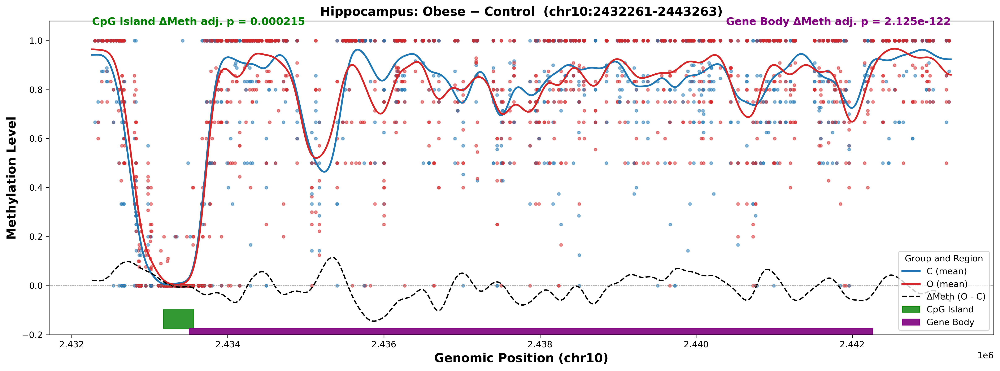

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_OvC/Hippocampus_OvC_methylation.pdf

=== Hippocampus_PvC: Control (blue) vs Pravastatin (red) ===


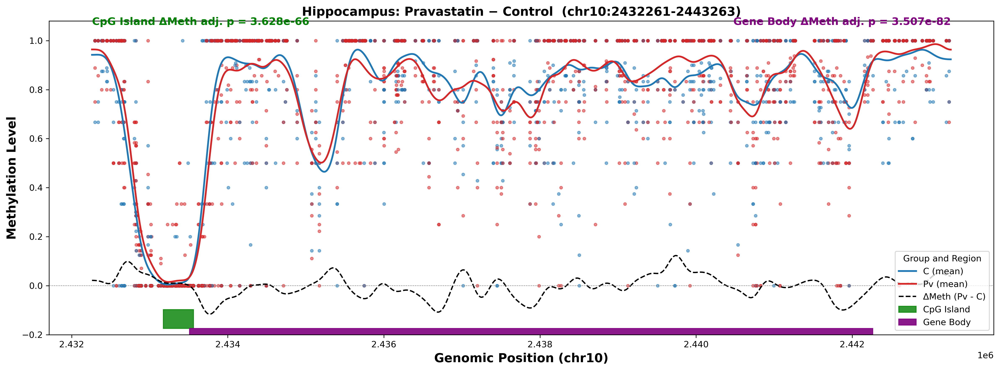

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_PvC/Hippocampus_PvC_methylation.pdf

=== Hippocampus_PvO: Pravastatin (blue) vs Obese (red) ===


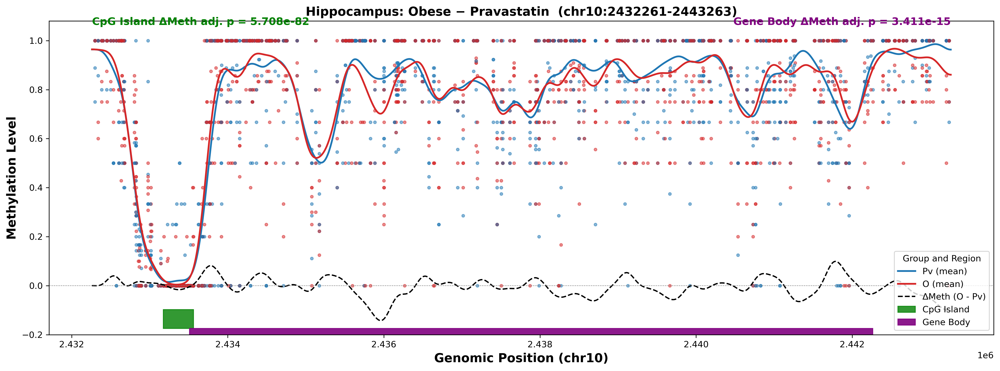

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_PvO/Hippocampus_PvO_methylation.pdf

=== Hippocampus_RvC: Control (blue) vs Restriction (red) ===


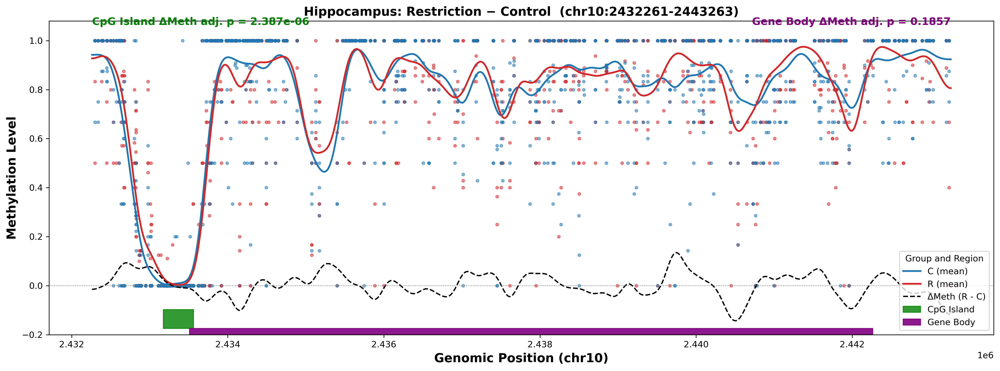

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_RvC/Hippocampus_RvC_methylation.pdf

=== Hippocampus_RvO: Restriction (blue) vs Obese (red) ===


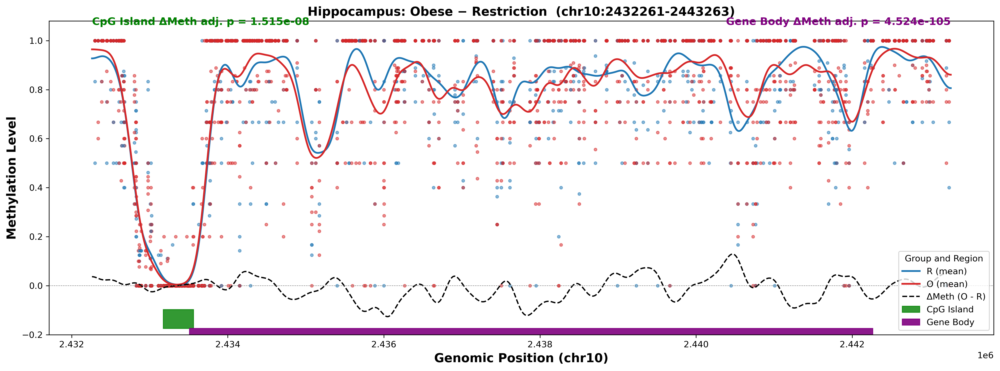

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_RvO/Hippocampus_RvO_methylation.pdf

=== Hypothalamus_OvC: Control (blue) vs Obese (red) ===


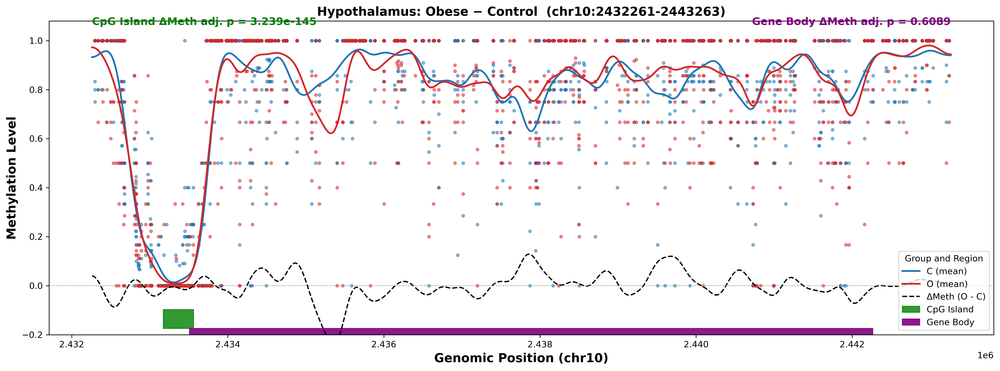

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_OvC/Hypothalamus_OvC_methylation.pdf

=== Hypothalamus_PvC: Control (blue) vs Pravastatin (red) ===


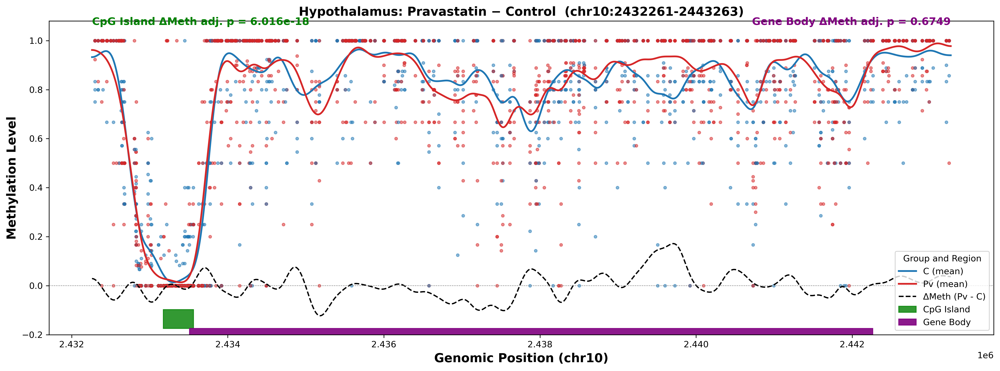

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_PvC/Hypothalamus_PvC_methylation.pdf

=== Hypothalamus_PvO: Pravastatin (blue) vs Obese (red) ===


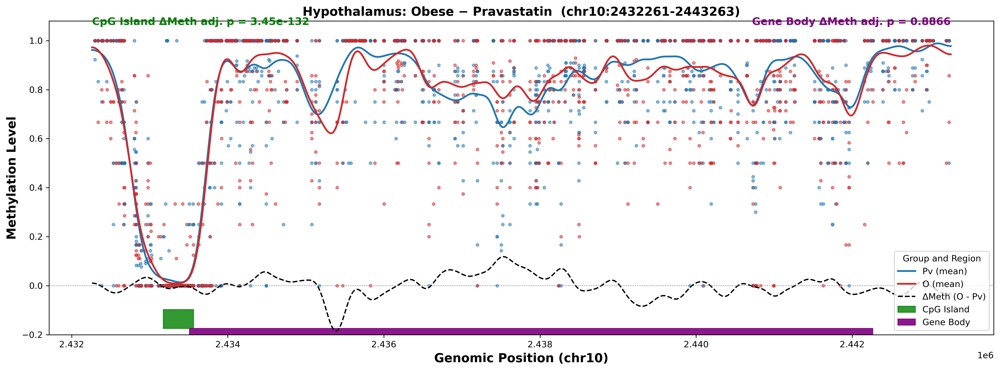

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_PvO/Hypothalamus_PvO_methylation.pdf

=== Hypothalamus_RvC: Control (blue) vs Restriction (red) ===


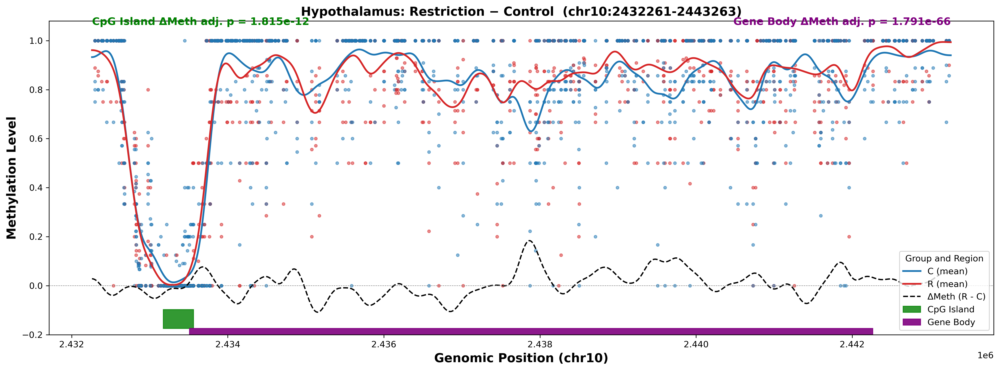

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_RvC/Hypothalamus_RvC_methylation.pdf

=== Hypothalamus_RvO: Restriction (blue) vs Obese (red) ===


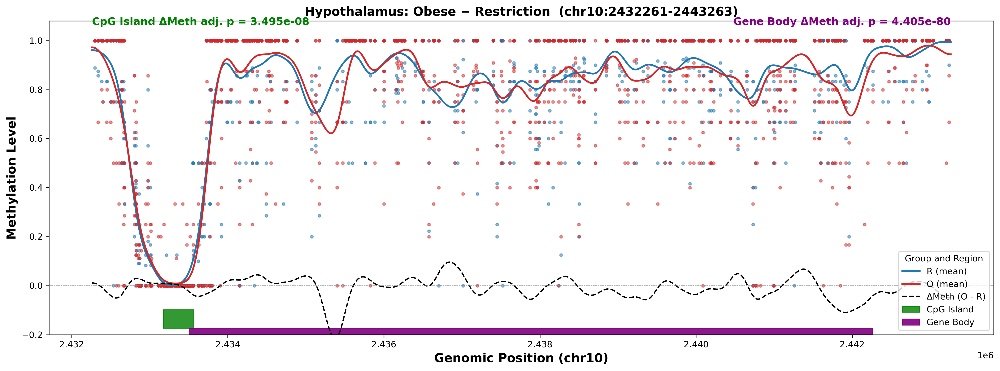

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_RvO/Hypothalamus_RvO_methylation.pdf

=== PrefrontalCortex_OvC: Control (blue) vs Obese (red) ===


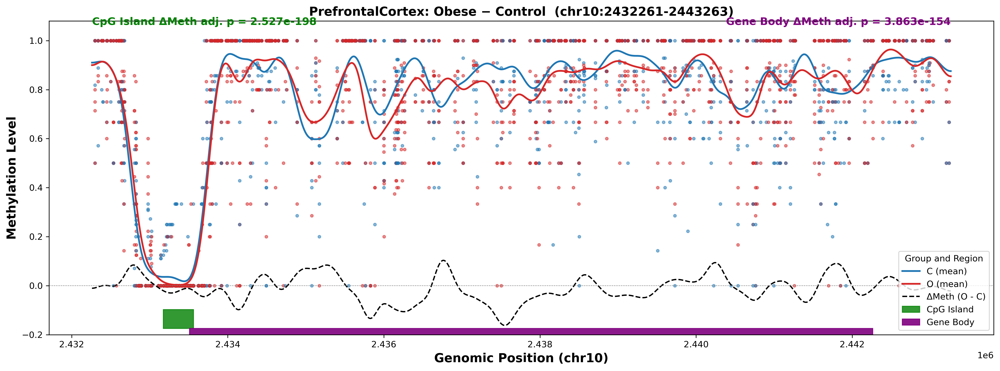

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_OvC/PrefrontalCortex_OvC_methylation.pdf

=== PrefrontalCortex_PvC: Control (blue) vs Pravastatin (red) ===


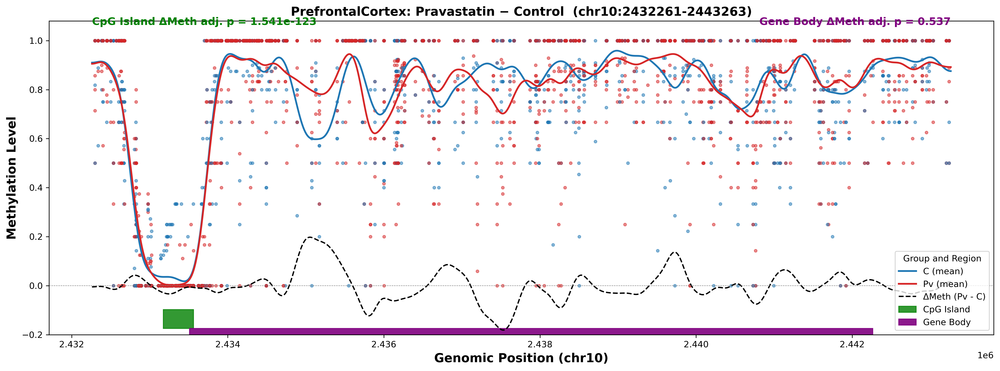

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_PvC/PrefrontalCortex_PvC_methylation.pdf

=== PrefrontalCortex_PvO: Pravastatin (blue) vs Obese (red) ===


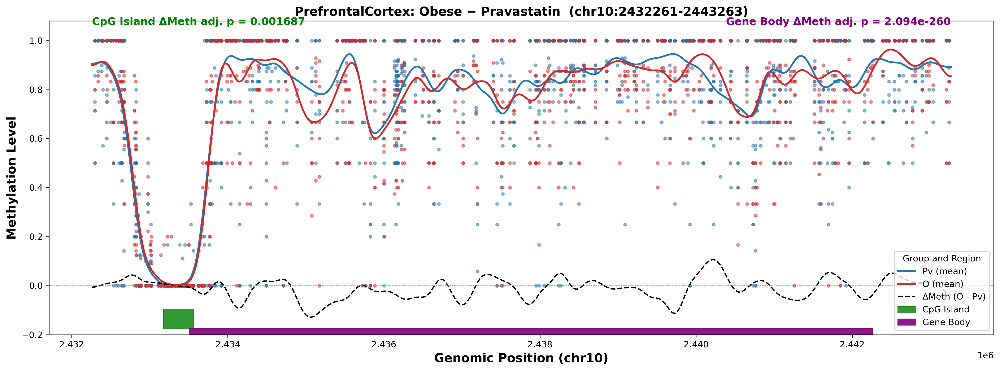

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_PvO/PrefrontalCortex_PvO_methylation.pdf

=== PrefrontalCortex_RvC: Control (blue) vs Restriction (red) ===


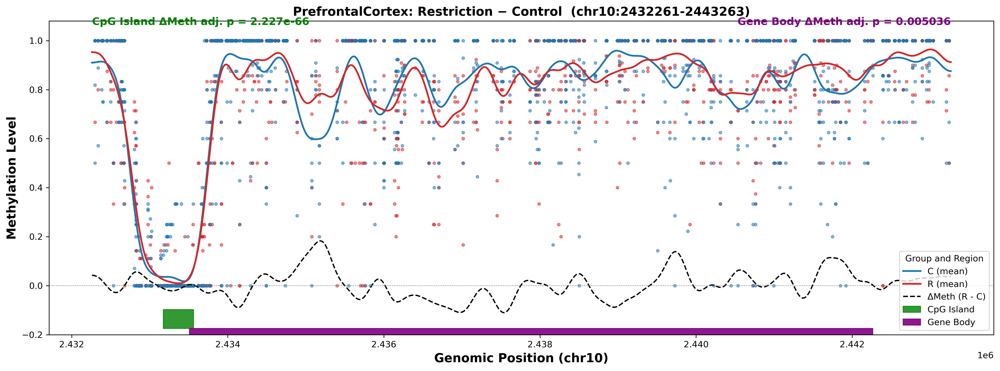

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_RvC/PrefrontalCortex_RvC_methylation.pdf

=== PrefrontalCortex_RvO: Restriction (blue) vs Obese (red) ===


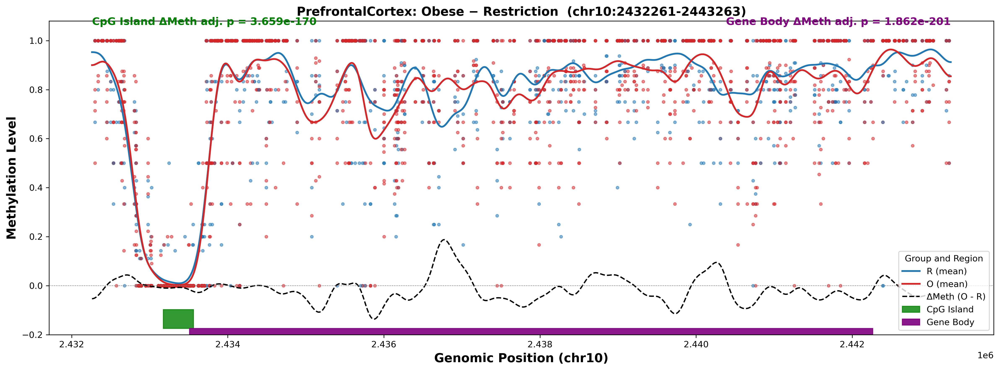

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_RvO/PrefrontalCortex_RvO_methylation.pdf

--- SUMMARY ---
Skipped (could not parse as comparison):
   10
   Ensembl_Update
   all
   cytosine_reports
   heatmaps


In [15]:
# corrected to plot all

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d
from scipy.stats import ttest_1samp
from statsmodels.stats.multitest import multipletests
from pathlib import Path
import matplotlib

# ---------- figure / PDF settings ----------
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
matplotlib.rcParams['figure.dpi'] = 300
matplotlib.rcParams['savefig.transparent'] = True
matplotlib.rcParams['path.simplify'] = False

# ============== CONFIG ==============
PROJECT = Path("/quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/")   # <-- change
DMRS_DIR = PROJECT / "DMRs"
METADATA = DMRS_DIR / "sample_info_master.csv"   # tab-separated

chrom = "chr10"
region_start = 2432261
region_end   = 2443263
region_positions = np.arange(region_start, region_end + 1)

cpg_start = 2433175
cpg_end   = 2433562
gene_body_start = region_start + 1250
gene_body_end   = region_end - 1000

SMOOTH_SIGMA = 100
POINT_SIZE = 10
POINT_ALPHA = 0.5
# ====================================

# metadata
meta = pd.read_csv(METADATA, sep="\t")
meta["Name"] = meta["Name"].astype(str)
meta["Group"] = meta["Group"].astype(str)
name_to_group = dict(zip(meta["Name"], meta["Group"]))

# folder-code → full group name
code_to_group = {
    "O": "Obese",
    "Pv": "Pravastatin",
    "R": "Restriction",
    "C": "Control",
}

group_label_short = {
    "Control": "C",
    "Obese": "O",
    "Restriction": "R",
    "Pravastatin": "Pv",
}

def parse_comparison_suffix(dmr_name: str):
    """
    Handles names like:
      Hypothalamus_RvC, Hippocampus_PvO, PrefrontalCortex_OvC, etc.
    Returns (region, [group1, group2]) as full names matching metadata.
    """
    if "_" not in dmr_name:
        return None, []

    region_part, comp_part = dmr_name.split("_", 1)

    # Folder pattern is always Letter1 v Letter2 (e.g., RvC)
    if "v" not in comp_part or len(comp_part) != 3:
        return region_part, []

    left_code = comp_part[0]   # e.g. 'R'
    right_code = comp_part[2]  # e.g. 'C'

    # Map single letters to full names
    code_to_group = {
        "O": "Obese",
        "P": "Pravastatin",
        "R": "Restriction",
        "C": "Control",
    }

    if left_code not in code_to_group or right_code not in code_to_group:
        return region_part, []

    groups = [code_to_group[left_code], code_to_group[right_code]]
    return region_part, groups



def load_roi_tsv(path):
    cols = ["chrom", "start", "end", "pct", "meth", "unmeth"]
    df = pd.read_csv(path, sep="\t", header=None, names=cols, compression="gzip")
    if df.empty:
        return pd.Series(dtype=float)
    df = df[df["chrom"] == chrom]
    df["frac"] = df["meth"] / (df["meth"] + df["unmeth"]).replace(0, np.nan)
    df = df.dropna(subset=["frac"])
    return pd.Series(df["frac"].values, index=df["start"].values)

def load_full_cov(path):
    # same columns as above but from full .cov.gz
    cols = ["chrom", "start", "end", "pct", "meth", "unmeth"]
    df = pd.read_csv(path, sep="\t", header=None, names=cols, compression="gzip")
    df = df[(df["chrom"] == chrom) &
            (df["start"] >= region_start) & (df["start"] <= region_end)]
    if df.empty:
        return pd.Series(dtype=float)
    df["frac"] = df["meth"] / (df["meth"] + df["unmeth"]).replace(0, np.nan)
    df = df.dropna(subset=["frac"])
    return pd.Series(df["frac"].values, index=df["start"].values)

def order_groups_for_plot(g1, g2):
    # always make control blue if it's present
    if g1 == "Control":
        return g1, g2
    if g2 == "Control":
        return g2, g1
    return g1, g2

skipped_parse = []
skipped_files = []

for dmr_dir in sorted(DMRS_DIR.iterdir()):
    if not dmr_dir.is_dir():
        continue

    dmr_name = dmr_dir.name
    region_label, groups_in_dir = parse_comparison_suffix(dmr_name)
    if not groups_in_dir or len(groups_in_dir) != 2:
        skipped_parse.append(dmr_name)
        continue

    g_a, g_b = groups_in_dir
    blue_group, red_group = order_groups_for_plot(g_a, g_b)

    # try ROI files first
    roi_files = glob.glob(str(dmr_dir / "*.roi.tsv.gz"))
    cov_files = glob.glob(str(dmr_dir / "*.cov.gz"))

    if not roi_files and not cov_files:
        skipped_files.append(dmr_name)
        continue

    print(f"\n=== {dmr_name}: {blue_group} (blue) vs {red_group} (red) ===")

    group_meth = {blue_group: {}, red_group: {}}
    fig, ax = plt.subplots(figsize=(16, 6))

    colors = {
        blue_group: "tab:blue",
        red_group: "tab:red",
    }

    # choose which files to iterate
    files_to_use = roi_files if roi_files else cov_files

    for fpath in sorted(files_to_use):
        base = os.path.basename(fpath)
        sample_name = base.split("_", 1)[0]
        if sample_name not in name_to_group:
            print(f"  WARNING: {base}: sample '{sample_name}' not in metadata, skipping.")
            continue
        sample_group = name_to_group[sample_name]
        if sample_group not in group_meth:
            # sample belongs to some third group, ignore
            continue

        if fpath.endswith(".roi.tsv.gz"):
            s = load_roi_tsv(fpath)
        else:
            s = load_full_cov(fpath)
        if s.empty:
            continue

        # scatter points
        ax.scatter(
            s.index.values,
            s.values,
            s=POINT_SIZE,
            alpha=POINT_ALPHA,
            color=colors[sample_group]
        )

        # stash for smoothing
        for pos, val in s.items():
            group_meth[sample_group].setdefault(int(pos), []).append(float(val))

    # build smoothed lines
    smoothed = {}
    for g in [blue_group, red_group]:
        vals = []
        for pos in region_positions:
            arr = group_meth[g].get(int(pos), [])
            vals.append(np.mean(arr) if arr else np.nan)
        series = pd.Series(vals, index=region_positions).interpolate(limit_direction="both")
        sm = gaussian_filter1d(series.values, sigma=SMOOTH_SIGMA)
        smoothed[g] = sm
        short = group_label_short.get(g, g)
        ax.plot(region_positions, sm,
                label=f"{short} (mean)",
                color=colors[g],
                linewidth=2)

    # delta = red - blue
    diff = smoothed[red_group] - smoothed[blue_group]
    ax.plot(region_positions, diff,
            label=f"ΔMeth ({group_label_short.get(red_group, red_group)} - {group_label_short.get(blue_group, blue_group)})",
            linestyle="--", color="black", linewidth=1.5)

    # t-tests for CpG island / gene body
    diff_mask = (region_positions >= cpg_start) & (region_positions <= gene_body_end)
    region_positions_diff = region_positions[diff_mask]
    diff_segment = diff[diff_mask]

    island_mask = (region_positions_diff >= cpg_start) & (region_positions_diff <= cpg_end)
    body_mask   = (region_positions_diff >= gene_body_start) & (region_positions_diff <= gene_body_end)

    island_diff = diff_segment[island_mask]
    body_diff   = diff_segment[body_mask]

    island_txt = "CpG Island ΔMeth adj. p = n/a"
    body_txt   = "Gene Body ΔMeth adj. p = n/a"

    if len(island_diff) >= 2:
        stat_i, pval_i = ttest_1samp(island_diff, 0)
        _, adj_i, _, _ = multipletests([pval_i], method="fdr_bh")
        island_txt = f"CpG Island ΔMeth adj. p = {adj_i[0]:.4g}"

    if len(body_diff) >= 2:
        stat_b, pval_b = ttest_1samp(body_diff, 0)
        _, adj_b, _, _ = multipletests([pval_b], method="fdr_bh")
        body_txt = f"Gene Body ΔMeth adj. p = {adj_b[0]:.4g}"

    # top text, like your reference figure
    ax.text(region_start, 1.055, island_txt,
            color="green", fontsize=12, weight="bold", va="bottom")
    ax.text(region_end, 1.055, body_txt,
            color="purple", fontsize=12, weight="bold", va="bottom", ha="right")

    # bottom bars
    ax.axvspan(cpg_start, cpg_end, ymin=0.02, ymax=0.08,
               color="green", alpha=0.8, label="CpG Island")
    ax.axvspan(gene_body_start, gene_body_end, ymin=0.0, ymax=0.02,
               color="purple", alpha=0.9, label="Gene Body")

    # cosmetics
    ax.axhline(0, linestyle='--', color='gray', linewidth=0.5)
    ax.set_xlabel("Genomic Position (chr10)", fontsize=14, weight='bold')
    ax.set_ylabel("Methylation Level", fontsize=14, weight='bold')
    ax.set_title(
        f"{region_label}: {red_group} − {blue_group}  (chr10:{region_start}-{region_end})",
        fontsize=14, weight='bold'
    )
    ax.set_ylim(-0.2, 1.08)
    ax.legend(title="Group and Region", loc="lower right")
    plt.tight_layout()

    out_pdf = dmr_dir / f"{dmr_name}_methylation.pdf"
    plt.savefig(out_pdf)
    plt.show()
    print(f"  saved {out_pdf}")

# -------- summary --------
print("\n--- SUMMARY ---")
if skipped_parse:
    print("Skipped (could not parse as comparison):")
    for x in skipped_parse:
        print("  ", x)
if skipped_files:
    print("Skipped (no ROI or cov.gz files):")
    for x in skipped_files:
        print("  ", x)



=== Hippocampus_OvC: Control (blue) vs Obese (red) ===
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_OvC/Hippocampus_OvC_methylation.pdf

=== Hippocampus_PvC: Control (blue) vs Pravastatin (red) ===
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_PvC/Hippocampus_PvC_methylation.pdf

=== Hippocampus_PvO: Pravastatin (blue) vs Obese (red) ===
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_PvO/Hippocampus_PvO_methylation.pdf

=== Hippocampus_RvC: Control (blue) vs Restriction (red) ===
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_RvC/Hippocampus_RvC_methylation.pdf

=== Hippocampus_RvO: Restriction (blue) vs Obese (red) ===
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_RvO/Hippocampus_RvO_methylation.pdf

=== Hypothalamus_OvC: Control

/tmp/ipykernel_3921793/2497177076.py:259: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


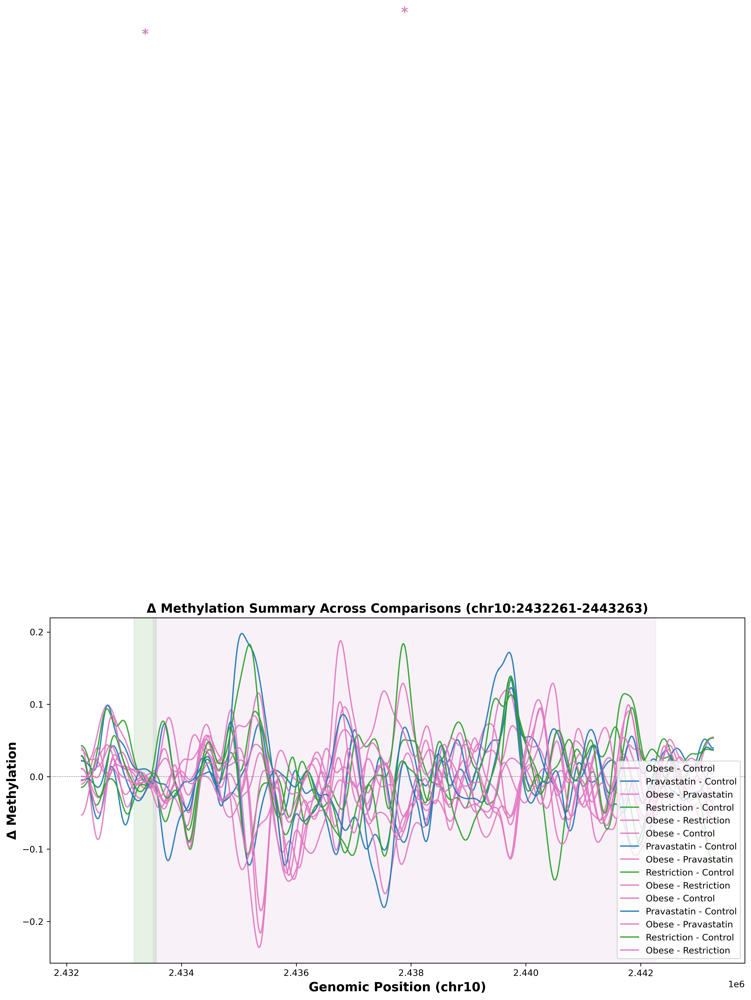


✅ Saved combined summary plots: overlap + stacked.


/tmp/ipykernel_3921793/2497177076.py:335: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  plt.tight_layout(rect=[0, 0, 1, 0.97])


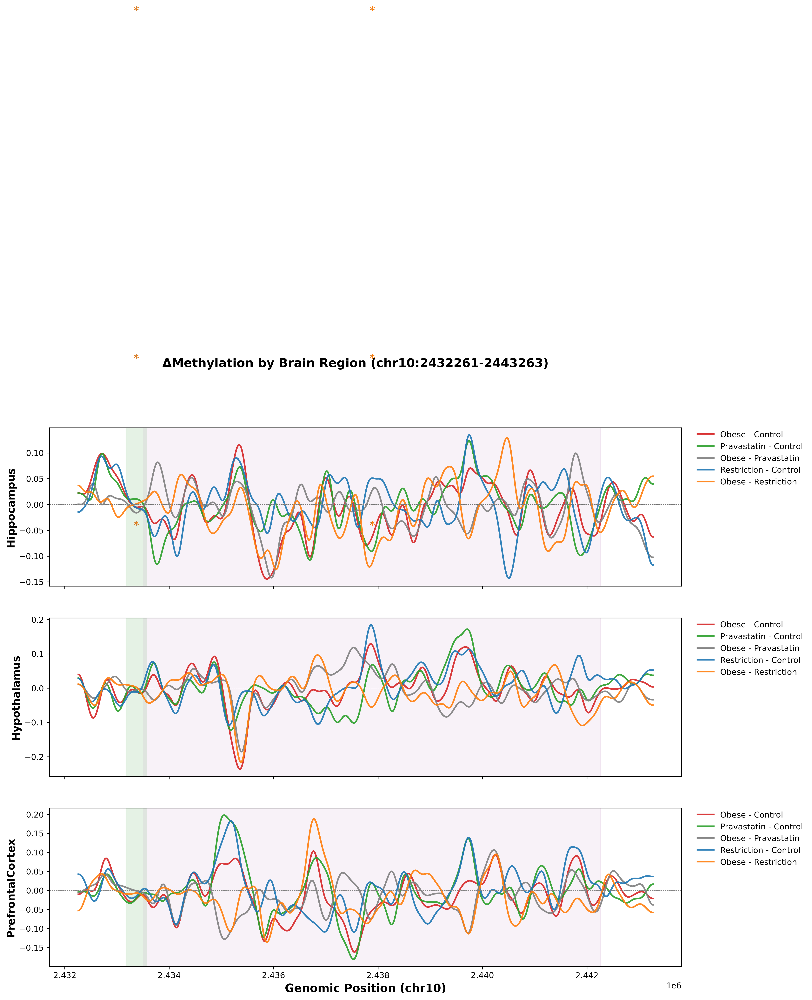


✅ Saved region-wise overlap plot: AllRegions_overlap_by_comparison.pdf


In [27]:
#combined plots

# corrected to plot all
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d
from scipy.stats import ttest_1samp
from statsmodels.stats.multitest import multipletests
from pathlib import Path
import matplotlib

# ---------- figure / PDF settings ----------
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
matplotlib.rcParams['figure.dpi'] = 300
matplotlib.rcParams['savefig.transparent'] = True
matplotlib.rcParams['path.simplify'] = False

# ============== CONFIG ==============
PROJECT = Path("/quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/")
DMRS_DIR = PROJECT / "DMRs"
METADATA = DMRS_DIR / "sample_info_master.csv"   # tab-separated

chrom = "chr10"
region_start = 2432261
region_end   = 2443263
region_positions = np.arange(region_start, region_end + 1)

cpg_start = 2433175
cpg_end   = 2433562
gene_body_start = region_start + 1250
gene_body_end   = region_end - 1000

SMOOTH_SIGMA = 100
POINT_SIZE = 10
POINT_ALPHA = 0.5
# ====================================

meta = pd.read_csv(METADATA, sep="\t")
meta["Name"] = meta["Name"].astype(str)
meta["Group"] = meta["Group"].astype(str)
name_to_group = dict(zip(meta["Name"], meta["Group"]))

group_label_short = {
    "Control": "C",
    "Obese": "O",
    "Restriction": "R",
    "Pravastatin": "P",
}

def parse_comparison_suffix(dmr_name: str):
    if "_" not in dmr_name:
        return None, []
    region_part, comp_part = dmr_name.split("_", 1)
    if "v" not in comp_part or len(comp_part) != 3:
        return region_part, []
    left_code = comp_part[0]
    right_code = comp_part[2]
    code_to_group = {
        "O": "Obese",
        "P": "Pravastatin",
        "R": "Restriction",
        "C": "Control",
    }
    if left_code not in code_to_group or right_code not in code_to_group:
        return region_part, []
    groups = [code_to_group[left_code], code_to_group[right_code]]
    return region_part, groups

def load_roi_tsv(path):
    cols = ["chrom", "start", "end", "pct", "meth", "unmeth"]
    df = pd.read_csv(path, sep="\t", header=None, names=cols, compression="gzip")
    if df.empty:
        return pd.Series(dtype=float)
    df = df[df["chrom"] == chrom]
    df["frac"] = df["meth"] / (df["meth"] + df["unmeth"]).replace(0, np.nan)
    df = df.dropna(subset=["frac"])
    return pd.Series(df["frac"].values, index=df["start"].values)

def load_full_cov(path):
    cols = ["chrom", "start", "end", "pct", "meth", "unmeth"]
    df = pd.read_csv(path, sep="\t", header=None, names=cols, compression="gzip")
    df = df[(df["chrom"] == chrom) & (df["start"] >= region_start) & (df["start"] <= region_end)]
    if df.empty:
        return pd.Series(dtype=float)
    df["frac"] = df["meth"] / (df["meth"] + df["unmeth"]).replace(0, np.nan)
    df = df.dropna(subset=["frac"])
    return pd.Series(df["frac"].values, index=df["start"].values)

def order_groups_for_plot(g1, g2):
    if g1 == "Control":
        return g1, g2
    if g2 == "Control":
        return g2, g1
    return g1, g2

# ------------------------------------------------
skipped_parse = []
skipped_files = []
summary_results = []   ### NEW ###
# ------------------------------------------------

for dmr_dir in sorted(DMRS_DIR.iterdir()):
    if not dmr_dir.is_dir():
        continue

    dmr_name = dmr_dir.name
    region_label, groups_in_dir = parse_comparison_suffix(dmr_name)
    if not groups_in_dir or len(groups_in_dir) != 2:
        skipped_parse.append(dmr_name)
        continue

    g_a, g_b = groups_in_dir
    blue_group, red_group = order_groups_for_plot(g_a, g_b)

    roi_files = glob.glob(str(dmr_dir / "*.roi.tsv.gz"))
    cov_files = glob.glob(str(dmr_dir / "*.cov.gz"))
    if not roi_files and not cov_files:
        skipped_files.append(dmr_name)
        continue

    print(f"\n=== {dmr_name}: {blue_group} (blue) vs {red_group} (red) ===")
    group_meth = {blue_group: {}, red_group: {}}
    fig, ax = plt.subplots(figsize=(16, 6))

    colors = {
        blue_group: "tab:blue",
        red_group: "tab:red",
    }

    files_to_use = roi_files if roi_files else cov_files

    for fpath in sorted(files_to_use):
        base = os.path.basename(fpath)
        sample_name = base.split("_", 1)[0]
        if sample_name not in name_to_group:
            print(f"  WARNING: {base}: sample '{sample_name}' not in metadata, skipping.")
            continue
        sample_group = name_to_group[sample_name]
        if sample_group not in group_meth:
            continue

        s = load_roi_tsv(fpath) if fpath.endswith(".roi.tsv.gz") else load_full_cov(fpath)
        if s.empty:
            continue

        ax.scatter(s.index.values, s.values, s=POINT_SIZE, alpha=POINT_ALPHA, color=colors[sample_group])
        for pos, val in s.items():
            group_meth[sample_group].setdefault(int(pos), []).append(float(val))

    smoothed = {}
    for g in [blue_group, red_group]:
        vals = [np.mean(group_meth[g].get(int(pos), [])) if group_meth[g].get(int(pos), []) else np.nan for pos in region_positions]
        series = pd.Series(vals, index=region_positions).interpolate(limit_direction="both")
        sm = gaussian_filter1d(series.values, sigma=SMOOTH_SIGMA)
        smoothed[g] = sm
        short = group_label_short.get(g, g)
        ax.plot(region_positions, sm, label=f"{short} (mean)", color=colors[g], linewidth=2)

    diff = smoothed[red_group] - smoothed[blue_group]
    ax.plot(region_positions, diff,
            label=f"ΔMeth ({group_label_short.get(red_group, red_group)} - {group_label_short.get(blue_group, blue_group)})",
            linestyle="--", color="black", linewidth=1.5)

    diff_mask = (region_positions >= cpg_start) & (region_positions <= gene_body_end)
    region_positions_diff = region_positions[diff_mask]
    diff_segment = diff[diff_mask]

    island_mask = (region_positions_diff >= cpg_start) & (region_positions_diff <= cpg_end)
    body_mask   = (region_positions_diff >= gene_body_start) & (region_positions_diff <= gene_body_end)

    island_diff = diff_segment[island_mask]
    body_diff   = diff_segment[body_mask]

    island_txt = "CpG Island ΔMeth adj. p = n/a"
    body_txt   = "Gene Body ΔMeth adj. p = n/a"
    adj_i = [np.nan]; adj_b = [np.nan]

    if len(island_diff) >= 2:
        stat_i, pval_i = ttest_1samp(island_diff, 0)
        _, adj_i, _, _ = multipletests([pval_i], method="fdr_bh")
        island_txt = f"CpG Island ΔMeth adj. p = {adj_i[0]:.4g}"

    if len(body_diff) >= 2:
        stat_b, pval_b = ttest_1samp(body_diff, 0)
        _, adj_b, _, _ = multipletests([pval_b], method="fdr_bh")
        body_txt = f"Gene Body ΔMeth adj. p = {adj_b[0]:.4g}"

    ax.text(region_start, 1.055, island_txt, color="green", fontsize=12, weight="bold", va="bottom")
    ax.text(region_end, 1.055, body_txt, color="purple", fontsize=12, weight="bold", va="bottom", ha="right")

    ax.axvspan(cpg_start, cpg_end, ymin=0.02, ymax=0.08, color="green", alpha=0.8, label="CpG Island")
    ax.axvspan(gene_body_start, gene_body_end, ymin=0.0, ymax=0.02, color="purple", alpha=0.9, label="Gene Body")

    ax.axhline(0, linestyle='--', color='gray', linewidth=0.5)
    ax.set_xlabel("Genomic Position (chr10)", fontsize=14, weight='bold')
    ax.set_ylabel("Methylation Level", fontsize=14, weight='bold')
    ax.set_title(f"{region_label}: {red_group} − {blue_group}  (chr10:{region_start}-{region_end})", fontsize=14, weight='bold')
    ax.set_ylim(-0.2, 1.08)
    ax.legend(title="Group and Region", loc="lower right")
    plt.tight_layout()

    out_pdf = dmr_dir / f"{dmr_name}_methylation.pdf"
    #plt.savefig(out_pdf)
    plt.close()
    print(f"  saved {out_pdf}")

    ### NEW: store results for summary ###
    summary_results.append({
        "region": region_label,
        "comparison": f"{red_group} - {blue_group}",
        "red_group": red_group,
        "blue_group": blue_group,
        "diff": diff,
        "adj_pval_island": adj_i[0],
        "adj_pval_body": adj_b[0],
    })

# -------- summary across comparisons --------
print("\n--- SUMMARY ---")
if skipped_parse:
    print("Skipped (could not parse as comparison):")
    for x in skipped_parse: print("  ", x)
if skipped_files:
    print("Skipped (no ROI or cov.gz files):")
    for x in skipped_files: print("  ", x)

# -------- combined plots --------
if summary_results:
    # --- Overlapping all comparisons ---
    plt.figure(figsize=(14, 7))
    for res in summary_results:
        color = "tab:pink" if res["red_group"] == "Obese" else "tab:green" if res["red_group"] == "Restriction" else "tab:blue"
        plt.plot(region_positions, res["diff"], label=res["comparison"], color=color, alpha=0.9)
        # mark significance
        if not np.isnan(res["adj_pval_island"]) and res["adj_pval_island"] < 0.05:
            plt.text((cpg_start + cpg_end)/2, 1.02, "*", color=color, fontsize=16, ha="center")
        if not np.isnan(res["adj_pval_body"]) and res["adj_pval_body"] < 0.05:
            plt.text((gene_body_start + gene_body_end)/2, 1.05, "*", color=color, fontsize=16, ha="center")
    ax.legend(
            bbox_to_anchor=(1.02, 1),   # move legend to the right of the plot
            loc="upper left",           # anchor it to the left edge of that box
            borderaxespad=0,            # reduce padding
            fontsize=10,
            frameon=False               # optional: removes box outline
        )

    
    plt.axvspan(cpg_start, cpg_end, color='green', alpha=0.1)
    plt.axvspan(gene_body_start, gene_body_end, color='purple', alpha=0.05)
    plt.axhline(0, linestyle='--', color='gray', linewidth=0.5)
    plt.xlabel("Genomic Position (chr10)", fontsize=14, weight='bold')
    plt.ylabel("Δ Methylation", fontsize=14, weight='bold')
    plt.title(f"Δ Methylation Summary Across Comparisons (chr10:{region_start}-{region_end})", fontsize=14, weight='bold')
    plt.legend(loc="lower right")
    plt.tight_layout()
    plt.savefig(DMRS_DIR / "AllComparisons_overlap.pdf")
    plt.show()

    # --- Stacked version ---
    n = len(summary_results)
    fig, axes = plt.subplots(n, 1, figsize=(14, 3*n), sharex=True)
    for i, res in enumerate(summary_results):
        ax = axes[i]
        color = "tab:red" if res["red_group"] == "Obese" else "tab:purple" if res["red_group"] == "Restriction" else "tab:green"
        ax.plot(region_positions, res["diff"], color=color, linewidth=2)
        ax.axvspan(cpg_start, cpg_end, color='green', alpha=0.1)
        ax.axvspan(gene_body_start, gene_body_end, color='purple', alpha=0.05)
        if not np.isnan(res["adj_pval_island"]) and res["adj_pval_island"] < 0.05:
            ax.text((cpg_start + cpg_end)/2, 0.9, "*", color=color, fontsize=14, ha="center")
        if not np.isnan(res["adj_pval_body"]) and res["adj_pval_body"] < 0.05:
            ax.text((gene_body_start + gene_body_end)/2, 0.9, "*", color=color, fontsize=14, ha="center")
        ax.axhline(0, linestyle='--', color='gray', linewidth=0.5)
        ax.set_ylabel(res["comparison"], fontsize=12, weight="bold")
        ax.set_ylim(-0.2, 1.05)
    axes[-1].set_xlabel(f"Genomic Position ({chrom})", fontsize=14, weight='bold')
    plt.tight_layout()
   # plt.savefig(DMRS_DIR / "AllComparisons_stacked.pdf")
    plt.show()
    print("\n✅ Saved combined summary plots: overlap + stacked.")

    # --- Region-wise overlapping summary ---
if summary_results:
    # 1. Group results by region
    regions = sorted(set(res["region"] for res in summary_results))
    n_regions = len(regions)
    fig, axes = plt.subplots(n_regions, 1, figsize=(14, 4*n_regions), sharex=True)

    # 2. Define colors for comparisons
    comp_colors = {
        "Obese - Restriction": "tab:orange",
        "Restriction - Control": "tab:blue",
        "Obese - Control": "tab:red",
        "Pravastatin - Control": "tab:green",
        "Obese - Pravastation": "tab:purple",
            }

    for ax, region in zip(axes, regions):
        # select all comparisons in this region
        region_comps = [r for r in summary_results if r["region"] == region]

        for res in region_comps:
            comp = res["comparison"]
            color = comp_colors.get(comp, "gray")

            ax.plot(region_positions, res["diff"], color=color, linewidth=2, alpha=0.9, label=comp)

            # significance marks
            if not np.isnan(res["adj_pval_island"]) and res["adj_pval_island"] < 0.05:
                ax.text((cpg_start + cpg_end)/2, 0.95, "*", color=color, fontsize=14, ha="center")
            if not np.isnan(res["adj_pval_body"]) and res["adj_pval_body"] < 0.05:
                ax.text((gene_body_start + gene_body_end)/2, 0.95, "*", color=color, fontsize=14, ha="center")

        # mark regions
        ax.axvspan(cpg_start, cpg_end, color='green', alpha=0.1)
        ax.axvspan(gene_body_start, gene_body_end, color='purple', alpha=0.05)

        ax.axhline(0, linestyle='--', color='gray', linewidth=0.5)
        ax.set_ylabel(f"{region}", fontsize=13, weight='bold')
        ax.legend(
            bbox_to_anchor=(1.02, 1),   # move legend to the right of the plot
            loc="upper left",           # anchor it to the left edge of that box
            borderaxespad=0,            # reduce padding
            fontsize=10,
            frameon=False               # optional: removes box outline
        )

        #ax.set_ylim(-0.3, 0.3)

    axes[-1].set_xlabel(f"Genomic Position ({chrom})", fontsize=14, weight='bold')
    plt.suptitle(f"ΔMethylation by Brain Region (chr10:{region_start}-{region_end})", fontsize=15, weight='bold')
    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.savefig(DMRS_DIR / "AllRegions_overlap_by_comparison.pdf")
    plt.show()
    print("\n✅ Saved region-wise overlap plot: AllRegions_overlap_by_comparison.pdf")



=== Hippocampus_OvC: Control (blue) vs Obese (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


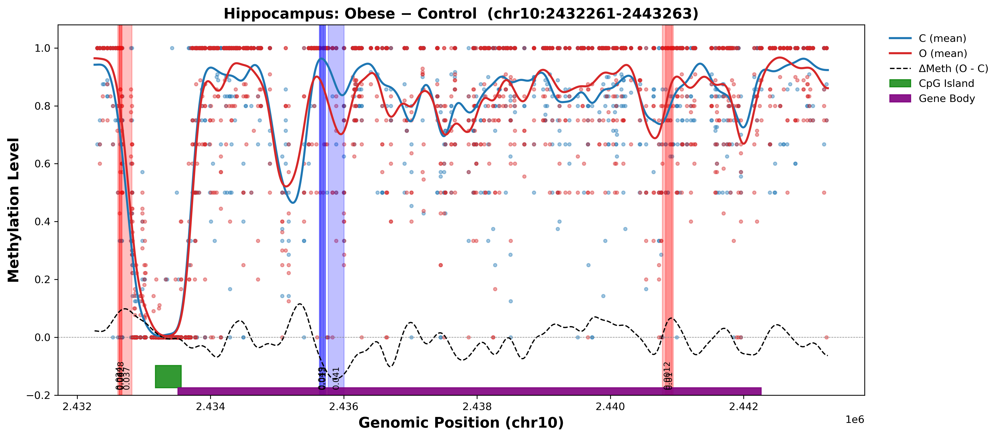

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_OvC/Hippocampus_OvC_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_OvC/Hippocampus_OvC_sigDMRs.bed

=== Hippocampus_PvC: Control (blue) vs Pravastatin (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


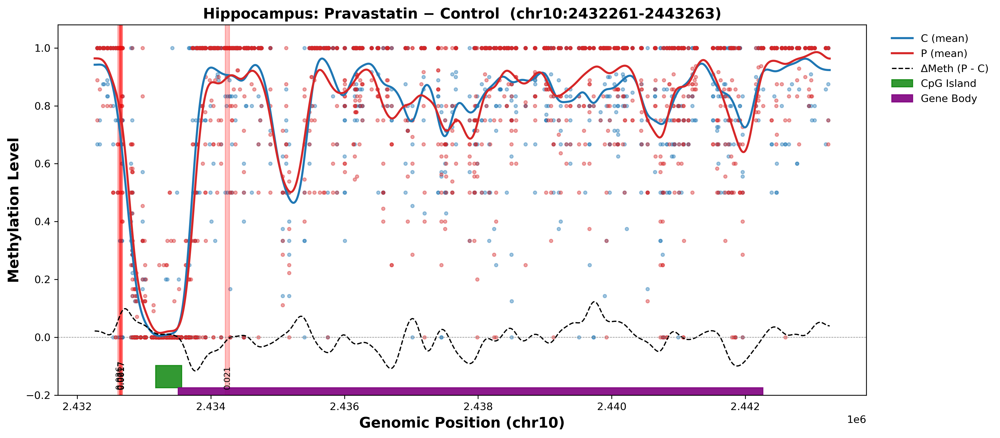

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_PvC/Hippocampus_PvC_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_PvC/Hippocampus_PvC_sigDMRs.bed

=== Hippocampus_PvO: Pravastatin (blue) vs Obese (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


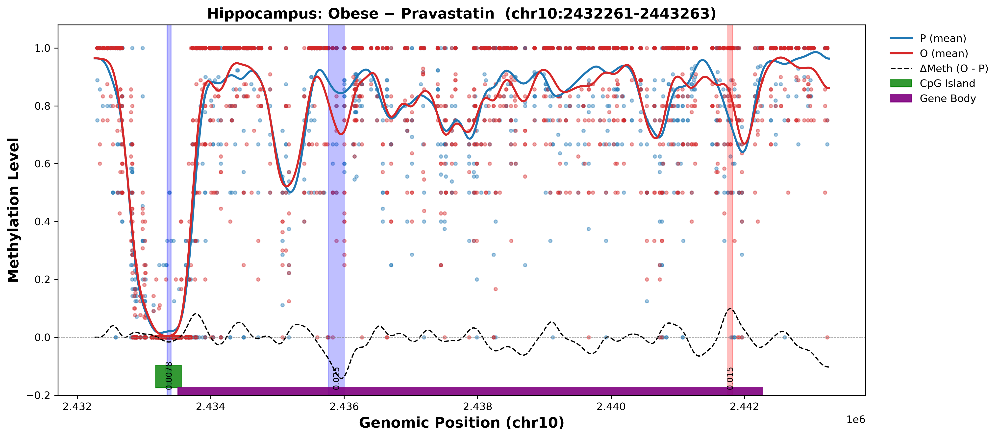

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_PvO/Hippocampus_PvO_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_PvO/Hippocampus_PvO_sigDMRs.bed

=== Hippocampus_RvC: Control (blue) vs Restriction (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


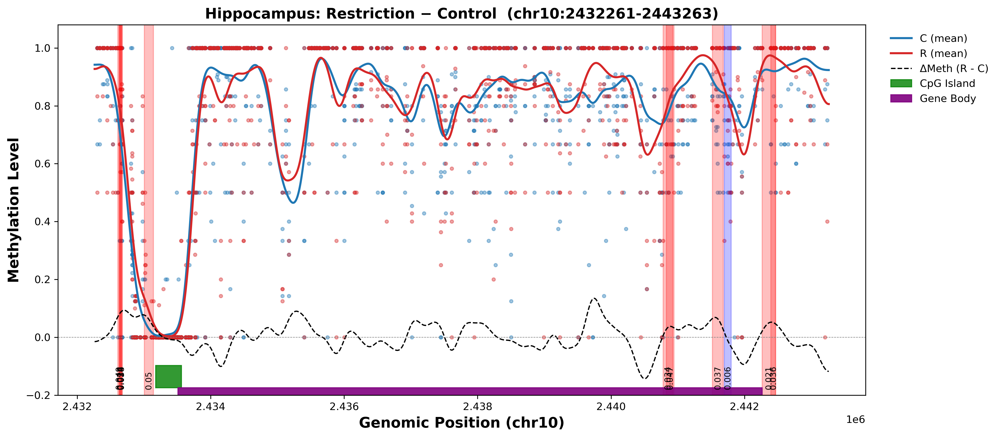

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_RvC/Hippocampus_RvC_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_RvC/Hippocampus_RvC_sigDMRs.bed

=== Hippocampus_RvO: Restriction (blue) vs Obese (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


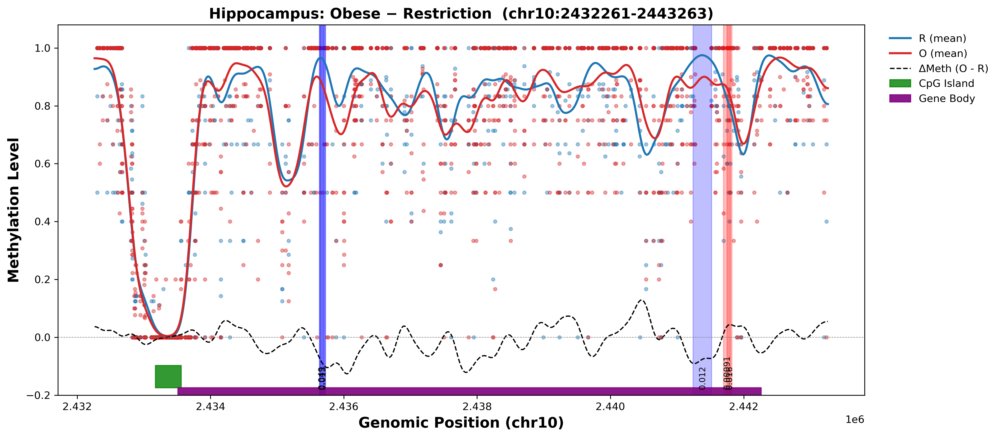

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_RvO/Hippocampus_RvO_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_RvO/Hippocampus_RvO_sigDMRs.bed

=== Hypothalamus_OvC: Control (blue) vs Obese (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


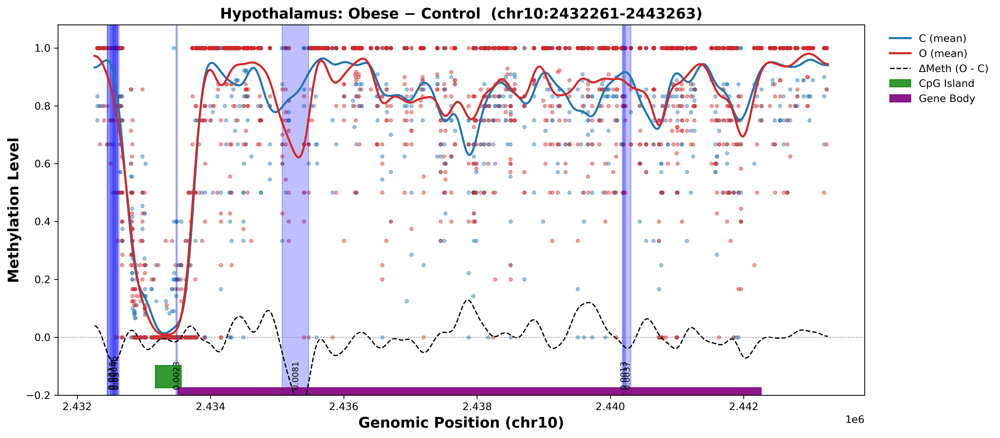

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_OvC/Hypothalamus_OvC_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_OvC/Hypothalamus_OvC_sigDMRs.bed

=== Hypothalamus_PvC: Control (blue) vs Pravastatin (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


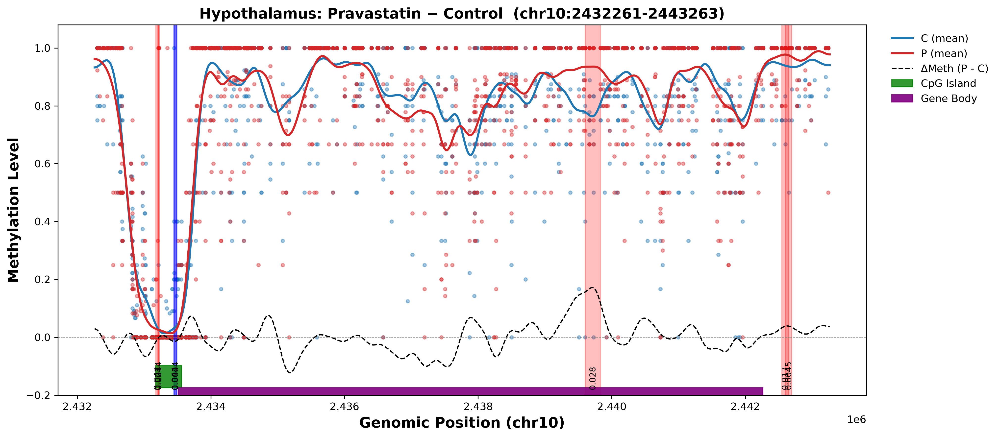

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_PvC/Hypothalamus_PvC_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_PvC/Hypothalamus_PvC_sigDMRs.bed

=== Hypothalamus_PvO: Pravastatin (blue) vs Obese (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


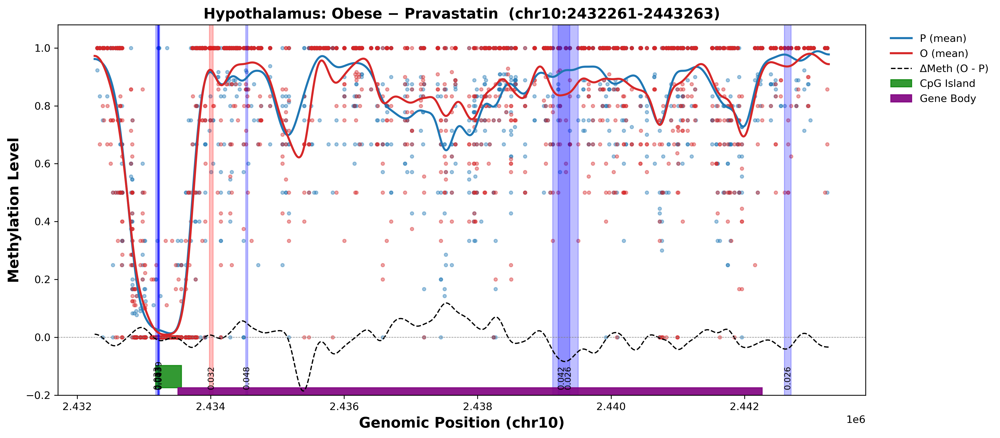

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_PvO/Hypothalamus_PvO_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_PvO/Hypothalamus_PvO_sigDMRs.bed

=== Hypothalamus_RvC: Control (blue) vs Restriction (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


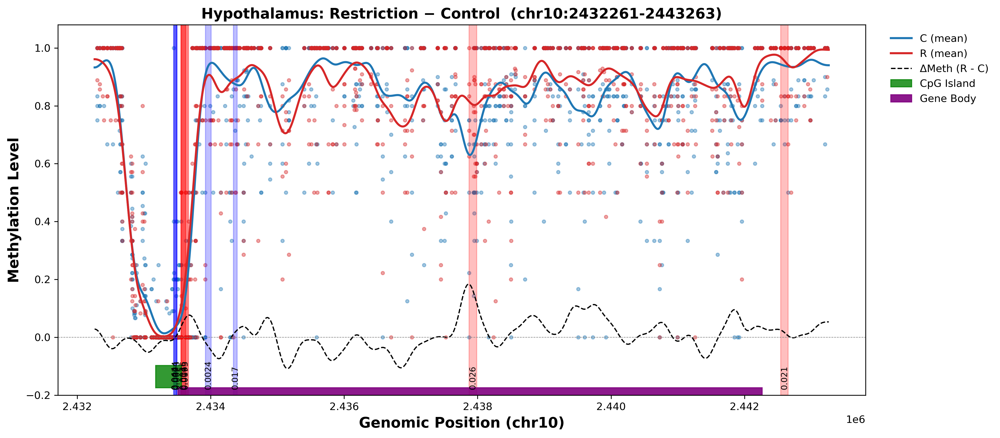

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_RvC/Hypothalamus_RvC_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_RvC/Hypothalamus_RvC_sigDMRs.bed

=== Hypothalamus_RvO: Restriction (blue) vs Obese (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


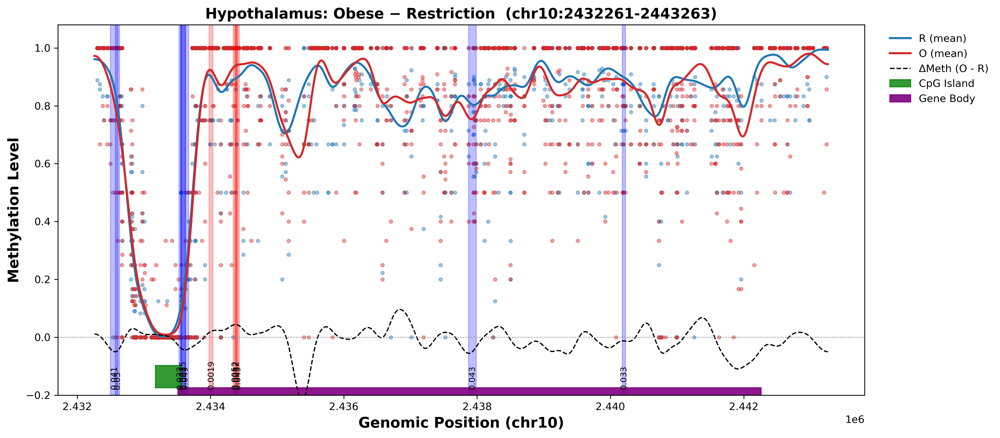

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_RvO/Hypothalamus_RvO_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_RvO/Hypothalamus_RvO_sigDMRs.bed

=== PrefrontalCortex_OvC: Control (blue) vs Obese (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


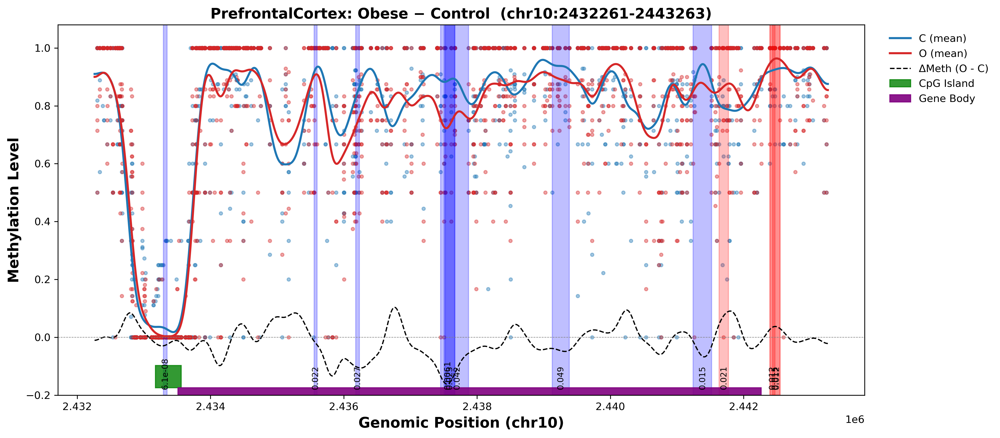

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_OvC/PrefrontalCortex_OvC_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_OvC/PrefrontalCortex_OvC_sigDMRs.bed

=== PrefrontalCortex_PvC: Control (blue) vs Pravastatin (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


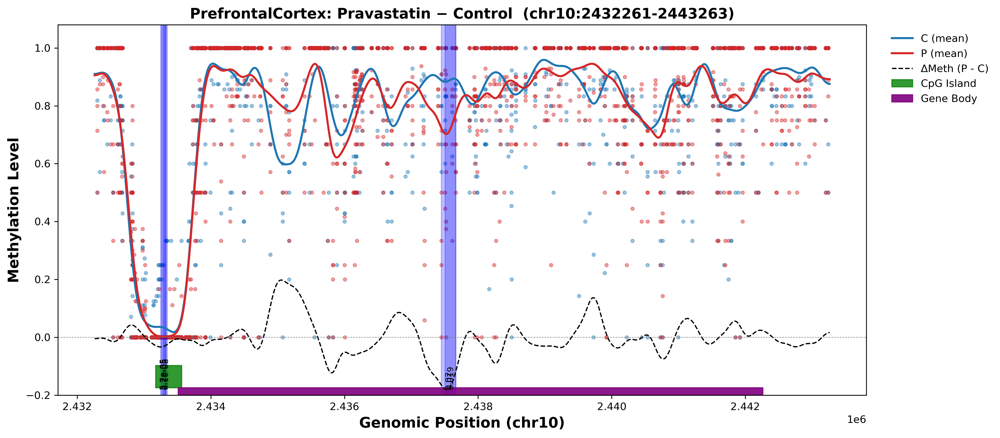

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_PvC/PrefrontalCortex_PvC_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_PvC/PrefrontalCortex_PvC_sigDMRs.bed

=== PrefrontalCortex_PvO: Pravastatin (blue) vs Obese (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


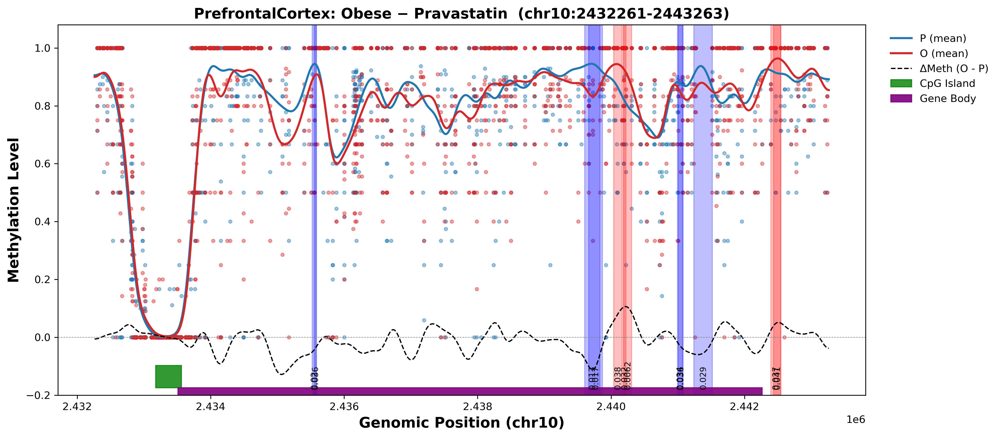

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_PvO/PrefrontalCortex_PvO_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_PvO/PrefrontalCortex_PvO_sigDMRs.bed

=== PrefrontalCortex_RvC: Control (blue) vs Restriction (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


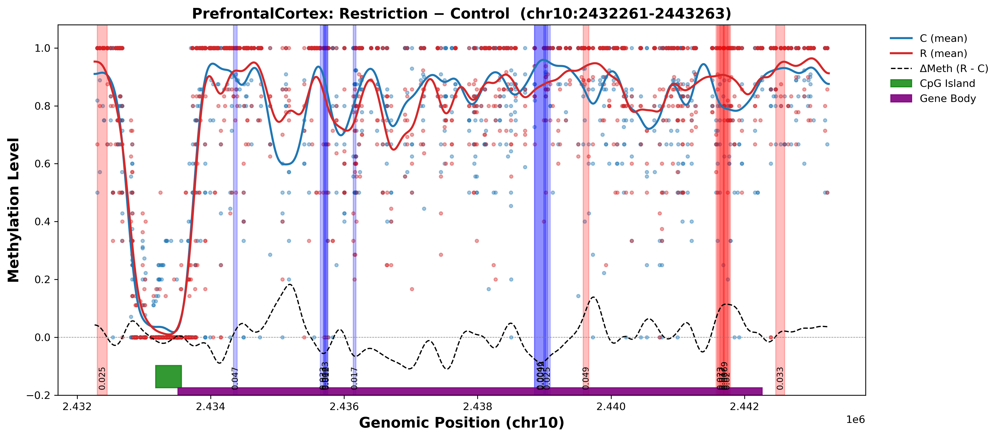

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_RvC/PrefrontalCortex_RvC_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_RvC/PrefrontalCortex_RvC_sigDMRs.bed

=== PrefrontalCortex_RvO: Restriction (blue) vs Obese (red) ===


/tmp/ipykernel_3921793/113791086.py:163: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')


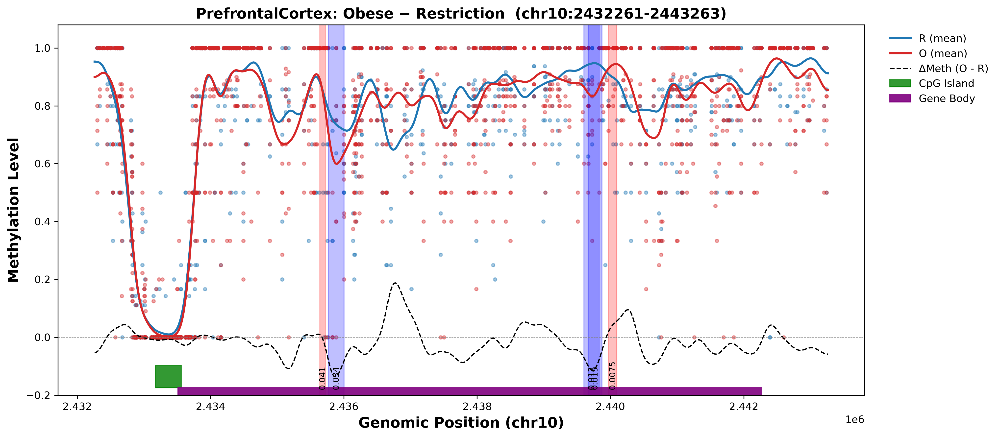

  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_RvO/PrefrontalCortex_RvO_methylation_scatter_with_DMRs.pdf
  saved /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_RvO/PrefrontalCortex_RvO_sigDMRs.bed


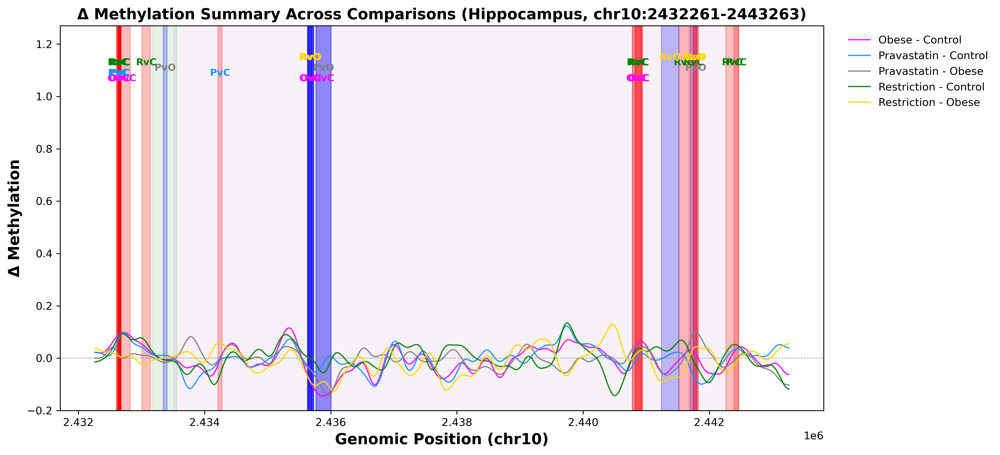

  saved combined /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hippocampus_combined_DeltaMethylation_with_DMRlabels.pdf


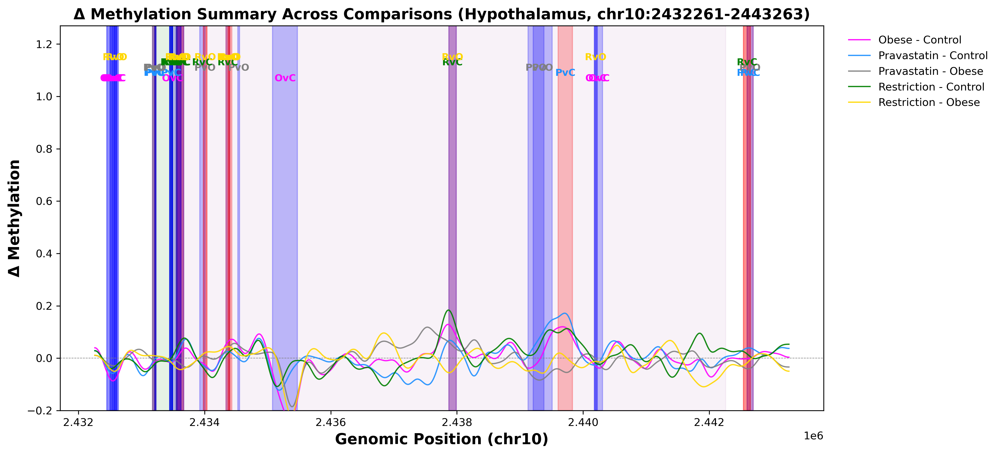

  saved combined /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/Hypothalamus_combined_DeltaMethylation_with_DMRlabels.pdf


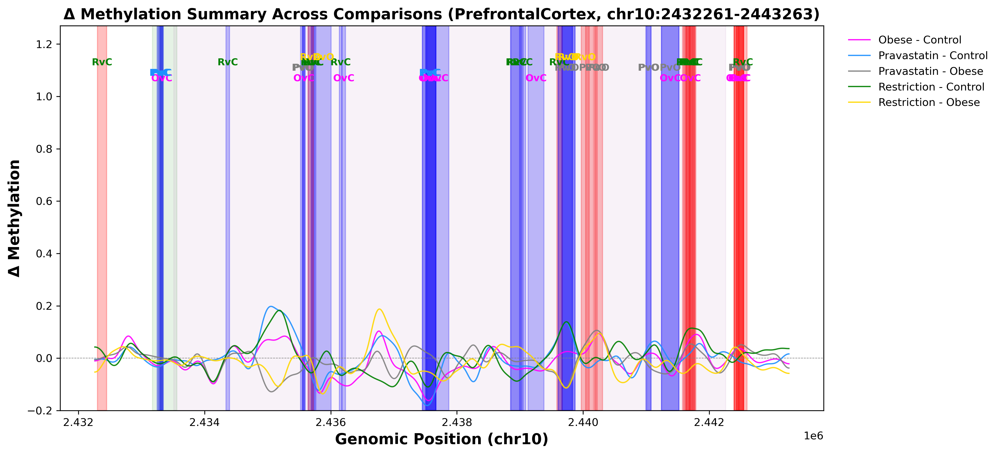

  saved combined /quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/DMRs/PrefrontalCortex_combined_DeltaMethylation_with_DMRlabels.pdf


In [36]:
# with dmrs and highlights in combined and scatter

#!/usr/bin/env python3
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter1d
from scipy.stats import ttest_ind
from pathlib import Path
import matplotlib

# ---------- Figure settings ----------
matplotlib.rcParams.update({
    'pdf.fonttype': 42,
    'ps.fonttype': 42,
    'figure.dpi': 300,
    'savefig.transparent': True,
    'path.simplify': False,
    'axes.labelweight': 'bold',
    'axes.titlesize': 14
})

# ============== CONFIG ==============
PROJECT = Path("/quobyte/lasallegrp/Ensi/project/nhip_macaque/fromBen_MacaqueObese_brain/")
DMRS_DIR = PROJECT / "DMRs"
METADATA = DMRS_DIR / "sample_info_master.csv"   # tab-separated

chrom = "chr10"
region_start = 2432261
region_end   = 2443263
region_positions = np.arange(region_start, region_end + 1)

# subregions
cpg_start = 2433175
cpg_end   = 2433562
gene_body_start = region_start + 1250
gene_body_end   = region_end - 1000

SMOOTH_SIGMA = 100
POINT_SIZE = 10
POINT_ALPHA = 0.4
WINDOW_SIZE = 5
MIN_DIFF = 0.05
PVAL_CUTOFF = 0.05
# ====================================

# metadata
meta = pd.read_csv(METADATA, sep="\t")
meta["Name"] = meta["Name"].astype(str)
meta["Group"] = meta["Group"].astype(str)
name_to_group = dict(zip(meta["Name"], meta["Group"]))

code_to_group = {"O": "Obese", "P": "Pravastatin", "R": "Restriction", "C": "Control"}
group_label_short = {"Control": "C", "Obese": "O", "Restriction": "R", "Pravastatin": "P"}

def parse_comparison_suffix(dmr_name: str):
    if "_" not in dmr_name:
        return None, []
    region_part, comp_part = dmr_name.split("_", 1)
    if "v" not in comp_part or len(comp_part) != 3:
        return region_part, []
    left_code, right_code = comp_part[0], comp_part[2]
    if left_code not in code_to_group or right_code not in code_to_group:
        return region_part, []
    return region_part, [code_to_group[left_code], code_to_group[right_code]]

def load_cov(path):
    cols = ["chrom", "start", "end", "pct", "meth", "unmeth"]
    df = pd.read_csv(path, sep="\t", header=None, names=cols, compression="gzip")
    df = df[(df["chrom"] == chrom) & (df["start"] >= region_start) & (df["start"] <= region_end)]
    if df.empty:
        return pd.Series(dtype=float)
    df["frac"] = df["meth"] / (df["meth"] + df["unmeth"]).replace(0, np.nan)
    df = df.dropna(subset=["frac"])
    return pd.Series(df["frac"].values, index=df["start"].values)

def order_groups_for_plot(g1, g2):
    if g1 == "Control": return g1, g2
    if g2 == "Control": return g2, g1
    return g1, g2

# store for combined plotting
combined_results = {}
combined_dmrs = {}

for dmr_dir in sorted(DMRS_DIR.iterdir()):
    if not dmr_dir.is_dir():
        continue

    dmr_name = dmr_dir.name
    region_label, groups_in_dir = parse_comparison_suffix(dmr_name)
    if not groups_in_dir or len(groups_in_dir) != 2:
        continue

    g_a, g_b = groups_in_dir
    blue_group, red_group = order_groups_for_plot(g_a, g_b)

    roi_files = glob.glob(str(dmr_dir / "*.roi.tsv.gz"))
    cov_files = glob.glob(str(dmr_dir / "*.cov.gz"))
    files_to_use = roi_files if roi_files else cov_files
    if not files_to_use:
        continue

    print(f"\n=== {dmr_name}: {blue_group} (blue) vs {red_group} (red) ===")
    group_meth = {blue_group: {}, red_group: {}}

    # collect per CpG methylation
    for fpath in sorted(files_to_use):
        base = os.path.basename(fpath)
        sample_name = base.split("_", 1)[0]
        if sample_name not in name_to_group:
            continue
        sample_group = name_to_group[sample_name]
        if sample_group not in group_meth:
            continue
        s = load_cov(fpath)
        if s.empty:
            continue
        for pos, val in s.items():
            group_meth[sample_group].setdefault(int(pos), []).append(float(val))

    # ---- scatter plot + smooth ----
    fig, ax = plt.subplots(figsize=(16, 6))
    colors = {blue_group: "tab:blue", red_group: "tab:red"}

    for g in [blue_group, red_group]:
        for pos, vals in group_meth[g].items():
            ax.scatter([pos] * len(vals), vals, s=POINT_SIZE, alpha=POINT_ALPHA, color=colors[g])

    smoothed = {}
    for g in [blue_group, red_group]:
        vals = [np.mean(group_meth[g].get(int(pos), [])) if group_meth[g].get(int(pos)) else np.nan
                for pos in region_positions]
        series = pd.Series(vals, index=region_positions).interpolate(limit_direction="both")
        sm = gaussian_filter1d(series.values, sigma=SMOOTH_SIGMA)
        smoothed[g] = sm
        ax.plot(region_positions, sm, label=f"{group_label_short.get(g,g)} (mean)",
                color=colors[g], linewidth=2)

    # Δ methylation
    diff = smoothed[red_group] - smoothed[blue_group]
    ax.plot(region_positions, diff, linestyle="--", color="black", linewidth=1.2,
            label=f"ΔMeth ({group_label_short.get(red_group,g_b)} - {group_label_short.get(blue_group,g_a)})")

    combined_results.setdefault(region_label, []).append((dmr_name, region_positions, diff))
    combined_dmrs.setdefault(region_label, {})

    # ---- Local DMR scan ----
    positions = sorted(set().union(*[group_meth[g].keys() for g in [blue_group, red_group]]))
    cpg_df = pd.DataFrame(index=positions)
    for g in [blue_group, red_group]:
        cpg_df[g] = [np.nanmean(group_meth[g].get(pos, [])) for pos in positions]
    cpg_df = cpg_df.dropna()
    cpg_df["diff"] = cpg_df[red_group] - cpg_df[blue_group]

    dmr_list = []
    for i in range(0, len(cpg_df) - WINDOW_SIZE, 1):
        window = cpg_df.iloc[i:i + WINDOW_SIZE]
        if len(window) < 3:
            continue
        stat, pval = ttest_ind(window[red_group], window[blue_group], nan_policy='omit')
        start, end = window.index.min(), window.index.max()
        mean_diff = np.nanmean(window["diff"])
        if pval < PVAL_CUTOFF and abs(mean_diff) > MIN_DIFF:
            dmr_list.append([start, end, mean_diff, pval])

    sig_dmrs = pd.DataFrame(dmr_list, columns=["start", "end", "mean_diff", "pval"])

    # highlight DMRs and label p-values
    for _, row in sig_dmrs.iterrows():
        color = "red" if row["mean_diff"] > 0 else "blue"
        ax.axvspan(row["start"], row["end"], color=color, alpha=0.25)
        ax.text((row["start"] + row["end"]) / 2, -0.18, f"{row['pval']:.2g}",
                color="black", fontsize=8, ha="center", va="bottom", rotation=90)

    # save DMRs for combined overlay
    combined_dmrs[region_label][f"{red_group}-{blue_group}"] = sig_dmrs

    # CpG island + gene body
    ax.axvspan(cpg_start, cpg_end, ymin=0.02, ymax=0.08, color="green", alpha=0.8, label="CpG Island")
    ax.axvspan(gene_body_start, gene_body_end, ymin=0.0, ymax=0.02, color="purple", alpha=0.9, label="Gene Body")

    # finalize
    ax.axhline(0, linestyle='--', color='gray', linewidth=0.5)
    ax.set_xlabel(f"Genomic Position ({chrom})", fontsize=14, weight='bold')
    ax.set_ylabel("Methylation Level", fontsize=14, weight='bold')
    ax.set_ylim(-0.2, 1.08)
    ax.set_title(f"{region_label}: {red_group} − {blue_group}  ({chrom}:{region_start}-{region_end})",
                 fontsize=14, weight='bold')
    ax.legend(bbox_to_anchor=(1.02, 1), loc="upper left", fontsize=10, frameon=False)
    plt.tight_layout(rect=[0, 0, 0.85, 1])

    out_pdf = dmr_dir / f"{dmr_name}_methylation_scatter_with_DMRs.pdf"
    plt.savefig(out_pdf)
    plt.show()
    print(f"  saved {out_pdf}")

    # BED output
    if not sig_dmrs.empty:
        bed_path = dmr_dir / f"{dmr_name}_sigDMRs.bed"
        sig_dmrs_out = sig_dmrs.copy()
        sig_dmrs_out["chrom"] = chrom
        sig_dmrs_out = sig_dmrs_out[["chrom", "start", "end", "mean_diff", "pval"]]
        #sig_dmrs_out.to_csv(bed_path, sep="\t", header=False, index=False)
        print(f"  saved {bed_path}")

# ---- Combined ΔMeth plots by brain region ----
# ---- Combined ΔMeth plots by brain region ----
comp_colors = {
    "Obese - Control": "magenta",
    "Pravastatin - Control": "dodgerblue",
    "Obese - Pravastatin": "orange",
    "Restriction - Control": "green",
    "Obese - Restriction": "orchid",
    "Restriction - Obese": "gold",
}

for region, comp_list in combined_results.items():
    fig, ax = plt.subplots(figsize=(16, 6))
    track_level = 0  # vertical offset for stacked DMR labels

    for dmr_name, pos, diff in comp_list:
        _, groups = parse_comparison_suffix(dmr_name)
        if not groups:
            continue
        comp = f"{groups[0]} - {groups[1]}"
        short = f"{group_label_short.get(groups[0],'?')}v{group_label_short.get(groups[1],'?')}"
        color = comp_colors.get(comp, "gray")

        # ΔMeth curve
        ax.plot(pos, diff, label=comp, color=color, alpha=0.9, linewidth=1.2, zorder=3)

        # pick correct DMR list (order may vary)
        if region in combined_dmrs and f"{groups[1]}-{groups[0]}" in combined_dmrs[region]:
            sig_df = combined_dmrs[region][f"{groups[1]}-{groups[0]}"]
        elif region in combined_dmrs and f"{groups[0]}-{groups[1]}" in combined_dmrs[region]:
            sig_df = combined_dmrs[region][f"{groups[0]}-{groups[1]}"]
        else:
            sig_df = pd.DataFrame()

        if not sig_df.empty:
            for _, row in sig_df.iterrows():
                dcol = "red" if row["mean_diff"] > 0 else "blue"
                # highlight region
                ax.axvspan(row["start"], row["end"], color=dcol, alpha=0.25, zorder=1)
                # label comparison above plot using comparison color
                ax.text((row["start"] + row["end"]) / 2,
                        1.05 + 0.02 * track_level,
                        short,
                        ha="center", va="bottom", fontsize=9,
                        color=color, weight="bold", rotation=0,
                        zorder=6)
            track_level += 1

    # CpG island & gene body regions
    ax.axvspan(cpg_start, cpg_end, color="green", alpha=0.1)
    ax.axvspan(gene_body_start, gene_body_end, color="purple", alpha=0.05)

    # baseline & styling
    ax.axhline(0, linestyle='--', color='gray', linewidth=0.5)
    ax.set_xlabel(f"Genomic Position ({chrom})", fontsize=14, weight='bold')
    ax.set_ylabel("Δ Methylation", fontsize=14, weight='bold')
    ax.set_title(f"Δ Methylation Summary Across Comparisons "
                 f"({region}, {chrom}:{region_start}-{region_end})",
                 fontsize=14, weight='bold')
    ax.set_ylim(-0.2, 1.12 + 0.03 * track_level)
    ax.legend(bbox_to_anchor=(1.02, 1), loc="upper left",
              frameon=False, fontsize=10)
    plt.tight_layout(rect=[0, 0, 0.82, 1])

    out_pdf = DMRS_DIR / f"{region}_combined_DeltaMethylation_with_DMRlabels.pdf"
    plt.savefig(out_pdf)
    plt.show()
    print(f"  saved combined {out_pdf}")


